In [2]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [3]:
df = pd.read_csv(r'C:\Users\HP\Desktop\Oreilly\kc_house_data.csv')

In [6]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [7]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df, title="Pandas Profiling Report")
profile

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [13]:
from sklearn.model_selection import RepeatedKFold
from tpot import TPOTRegressor

X = df.drop(['price', 'date', 'id'], axis=1)
y = df['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8)

In [14]:
# define evaluation procedure
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# define search
model = TPOTRegressor(generations=5, population_size=50, scoring='neg_mean_absolute_error', cv=cv, verbosity=2, random_state=1, n_jobs=-1)
# perform the search
model.fit(X_train, y_train)
# export the best model
model.export('tpot_insurance_best_model.py')

Optimization Progress:   0%|          | 0/300 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -72435.79650381378

Generation 2 - Current best internal CV score: -72435.79650381378

Generation 3 - Current best internal CV score: -71035.04789922858

Generation 4 - Current best internal CV score: -70540.94598138775

Generation 5 - Current best internal CV score: -70540.94598138775

Best pipeline: ExtraTreesRegressor(ElasticNetCV(input_matrix, l1_ratio=0.25, tol=0.1), bootstrap=True, max_features=0.9000000000000001, min_samples_leaf=1, min_samples_split=3, n_estimators=100)


In [21]:
model.fitted_pipeline_

Pipeline(memory=None,
         steps=[('stackingestimator',
                 StackingEstimator(estimator=ElasticNetCV(alphas=None,
                                                          copy_X=True, cv=None,
                                                          eps=0.001,
                                                          fit_intercept=True,
                                                          l1_ratio=0.25,
                                                          max_iter=1000,
                                                          n_alphas=100,
                                                          n_jobs=None,
                                                          normalize=False,
                                                          positive=False,
                                                          precompute='auto',
                                                          random_state=1,
                                                     

In [20]:
model.score(X_test, y_test)

-70082.64790273376

In [22]:
import h2o
from h2o.automl import H2OAutoML

h2o.init(
    nthreads=-1,     # number of threads when launching a new H2O server
    max_mem_size=2  # in gigabytes
)

data = h2o.import_file(r'C:\Users\HP\Desktop\Oreilly\kc_house_data.csv')

splits = data.split_frame(ratios=[0.7, 0.15], seed=1)  

train = splits[0]
valid = splits[1]
test = splits[2]

x = list(data.columns)
y = "price"
x.remove(y)

aml = H2OAutoML(max_models=10, seed=1)
aml.train(x=x, y=y, training_frame=train)

lb = aml.leaderboard
lb.head(rows=lb.nrows)

preds = aml.leader.predict(test)



Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
; Java HotSpot(TM) 64-Bit Server VM (build 25.311-b11, mixed mode)
  Starting server from c:\users\hp\appdata\local\programs\python\python37\lib\site-packages\h2o\backend\bin\h2o.jar
  Ice root: C:\Users\HP\AppData\Local\Temp\tmpnt_n2lkg
  JVM stdout: C:\Users\HP\AppData\Local\Temp\tmpnt_n2lkg\h2o_HP_started_from_python.out
  JVM stderr: C:\Users\HP\AppData\Local\Temp\tmpnt_n2lkg\h2o_HP_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,08 secs
H2O_cluster_timezone:,Europe/Paris
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.34.0.3
H2O_cluster_version_age:,2 months and 4 days
H2O_cluster_name:,H2O_from_python_HP_4g31ri
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,1.778 Gb
H2O_cluster_total_cores:,4
H2O_cluster_allowed_cores:,4
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |
13:22:11.498: AutoML: XGBoost is not available; skipping it.
13:22:11.545: Step 'best_of_family_xgboost' not defined in provider 'StackedEnsemble': skipping it.
13:22:11.546: Step 'all_xgboost' not defined in provider 'StackedEnsemble': skipping it.

███████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


In [24]:
print(lb)

model_id,mean_residual_deviance,rmse,mse,mae,rmsle
StackedEnsemble_AllModels_3_AutoML_1_20211211_132211,1.80094e+10,134199,1.80094e+10,76014.6,0.185218
StackedEnsemble_BestOfFamily_4_AutoML_1_20211211_132211,1.80649e+10,134406,1.80649e+10,76075,0.185338
StackedEnsemble_AllModels_5_AutoML_1_20211211_132211,1.8191e+10,134874,1.8191e+10,75130,0.183382
StackedEnsemble_BestOfFamily_6_AutoML_1_20211211_132211,1.82737e+10,135180,1.82737e+10,75091.5,0.18366
StackedEnsemble_AllModels_2_AutoML_1_20211211_132211,1.83171e+10,135341,1.83171e+10,76994.5,0.187146
StackedEnsemble_BestOfFamily_3_AutoML_1_20211211_132211,1.83229e+10,135362,1.83229e+10,77019.7,0.187197
StackedEnsemble_AllModels_4_AutoML_1_20211211_132211,1.89241e+10,137565,1.89241e+10,74572.1,0.18236
StackedEnsemble_BestOfFamily_5_AutoML_1_20211211_132211,1.90125e+10,137886,1.90125e+10,74769.7,0.183095
XRT_1_AutoML_1_20211211_132211,2.10511e+10,145090,2.10511e+10,79019.6,0.193225
DeepLearning_1_AutoML_1_20211211_132211,2.12389e+10,145736,2.12389e+10,86327.8,0.211017


In [27]:
print(aml.leader)

Model Details
H2OStackedEnsembleEstimator :  Stacked Ensemble
Model Key:  StackedEnsemble_AllModels_3_AutoML_1_20211211_132211

No model summary for this model

ModelMetricsRegressionGLM: stackedensemble
** Reported on train data. **

MSE: 6368859512.891763
RMSE: 79805.13462736444
MAE: 48303.461061361544
RMSLE: 0.12377193832242764
R^2: 0.9549671316108768
Mean Residual Deviance: 6368859512.891763
Null degrees of freedom: 10056
Residual degrees of freedom: 10053
Null deviance: 1422406243665573.5
Residual deviance: 64051620121152.46
AIC: 255584.1492745215

ModelMetricsRegressionGLM: stackedensemble
** Reported on cross-validation data. **

MSE: 18009414121.7873
RMSE: 134199.15842428856
MAE: 76014.57087308555
RMSLE: 0.18521761273240997
R^2: 0.8719127528737765
Mean Residual Deviance: 18009414121.7873
Null degrees of freedom: 15196
Residual degrees of freedom: 15193
Null deviance: 2136906049113388.0
Residual deviance: 273689066408801.62
AIC: 402001.6143631283



In [26]:
print(preds)

predict
312975
422664
601736
446918
983432
536389
508775
621960
361067
304379


In [25]:
from h2o.estimators.glm import H2OGeneralizedLinearEstimator

glm_fit1 = H2OGeneralizedLinearEstimator(model_id='glm_fit1')

glm_fit1.train(x=x, y=y, training_frame=train)
glm_fit2 = H2OGeneralizedLinearEstimator(model_id='glm_fit2', lambda_search=True)
glm_fit2.train(x=x, y=y, training_frame=train, validation_frame=valid)



glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
Model Details
H2OGeneralizedLinearEstimator :  Generalized Linear Modeling
Model Key:  glm_fit2


GLM Model: summary


,,family,link,regularization,lambda_search,number_of_predictors_total,number_of_active_predictors,number_of_iterations,training_frame
0,,gaussian,identity,"Elastic Net (alpha = 0.5, lambda = 361860.0 )","nlambda = 100, lambda.max = 524990.0, lambda.min = 361860.0, lambd...",391,5,5,py_2_sid_aebd




ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 140602045156.702
RMSE: 374969.3922931604
MAE: 236580.71994163078
RMSLE: 0.551696008581866
R^2: 4.7318223568293405e-06
Mean Residual Deviance: 140602045156.702
Null degrees of freedom: 15196
Residual degrees of freedom: 15191
Null deviance: 2136739390917621.0
Residual deviance: 2136729280246400.2
AIC: 433236.04048465943

ModelMetricsRegressionGLM: glm
** Reported on validation data. **

MSE: 127285034499.86203
RMSE: 356770.2825346613
MAE: 234190.00127554638
RMSLE: 0.5465661591360187
R^2: -0.0003035965640985072
Mean Residual Deviance: 127285034499.86203
Null degrees of freedom: 3226
Residual degrees of freedom: 3221
Null deviance: 410750877817952.8
Residual deviance: 410748806331054.75
AIC: 91685.23433131812

Scoring History: 


,,timestamp,duration,iteration,lambda,predictors,deviance_train,deviance_test,alpha,iterations,training_rmse,training_deviance,training_mae,training_r2,validation_rmse,validation_deviance,validation_mae,validation_r2
0,,2021-12-11 13:28:28,0.000 sec,1,",52E6",1,1.406027e+11,1.272857e+11,0.5,NaN,,,,,,,,
1,,2021-12-11 13:28:28,0.001 sec,2,",48E6",3,1.406026e+11,1.272856e+11,0.5,NaN,,,,,,,,
2,,2021-12-11 13:28:28,0.007 sec,3,",44E6",5,1.406025e+11,1.272855e+11,0.5,NaN,,,,,,,,
3,,2021-12-11 13:28:28,0.020 sec,4,",4E6",5,1.406023e+11,1.272853e+11,0.5,NaN,,,,,,,,
4,,2021-12-11 13:28:28,0.028 sec,5,",36E6",6,1.406020e+11,1.272850e+11,0.5,5.0,374969,1.40602e+11,236581,4.73182e-06,356770,1.27285e+11,234190,-0.000303597



Variable Importances: 


,variable,relative_importance,scaled_importance,percentage
0,sqft_living,0.450824,1.000000,0.327378
1,grade,0.378579,0.839750,0.274916
2,sqft_above,0.252709,0.560550,0.183512
3,sqft_living15,0.209073,0.463758,0.151824
4,bathrooms,0.085889,0.190516,0.062371
5,date.20140502T000000,0.000000,0.000000,0.000000
6,date.20140503T000000,0.000000,0.000000,0.000000
7,date.20140504T000000,0.000000,0.000000,0.000000
8,date.20140505T000000,0.000000,0.000000,0.000000
9,date.20140506T000000,0.000000,0.000000,0.000000



See the whole table with table.as_data_frame()


In [29]:
from h2o.estimators.random_forest import H2ORandomForestEstimator
rf_fit1 = H2ORandomForestEstimator(model_id='rf_fit1', seed=1)
rf_fit1.train(x=x, y=y, training_frame=train)

rf_fit2 = H2ORandomForestEstimator(model_id='rf_fit2', ntrees=100, seed=1)
rf_fit2.train(x=x, y=y, training_frame=train)

rf_perf1 = rf_fit1.model_performance(test)
rf_perf2 = rf_fit2.model_performance(test)

print(rf_perf1)
print(rf_perf2)

drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%

ModelMetricsRegression: drf
** Reported on test data. **

MSE: 20965115575.874184
RMSE: 144793.35473658377
MAE: 79876.73313778809
RMSLE: 0.19703230327773485
Mean Residual Deviance: 20965115575.874184


ModelMetricsRegression: drf
** Reported on test data. **

MSE: 20620731929.303696
RMSE: 143599.20587978087
MAE: 78692.68241241867
RMSLE: 0.19498358304952695
Mean Residual Deviance: 20620731929.303696



In [31]:
# Import H2O GBM:
from h2o.estimators.gbm import H2OGradientBoostingEstimator

# Initialize and train the GBM estimator:

gbm_fit1 = H2OGradientBoostingEstimator(model_id='gbm_fit1', seed=1)
gbm_fit1.train(x=x, y=y, training_frame=train)

gbm_fit2 = H2OGradientBoostingEstimator(model_id='gbm_fit2', ntrees=500, seed=1)
gbm_fit2.train(x=x, y=y, training_frame=train)

# Now let's use early stopping to find optimal ntrees

gbm_fit3 = H2OGradientBoostingEstimator(model_id='gbm_fit3', 
                                        ntrees=500, 
                                        score_tree_interval=5,     #used for early stopping
                                        stopping_rounds=3,         #used for early stopping
                                        stopping_tolerance=0.0005, #used for early stopping
                                        seed=1)

# The use of a validation_frame is recommended with using early stopping
gbm_fit3.train(x=x, y=y, training_frame=train, validation_frame=valid)

gbm_perf1 = gbm_fit1.model_performance(test)
gbm_perf2 = gbm_fit2.model_performance(test)
gbm_perf3 = gbm_fit3.model_performance(test)

# Retreive test set AUC
print(gbm_perf1)
print(gbm_perf2)
print(gbm_perf3)

gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%

ModelMetricsRegression: gbm
** Reported on test data. **

MSE: 24428594653.758728
RMSE: 156296.495974026
MAE: 83062.37000602562
RMSLE: 0.20263363779799398
Mean Residual Deviance: 24428594653.758728


ModelMetricsRegression: gbm
** Reported on test data. **

MSE: 23008939894.197666
RMSE: 151686.97997586234
MAE: 81650.66014625099
RMSLE: 0.20278911299921476
Mean Residual Deviance: 23008939894.197666


ModelMetricsRegression: gbm
** Reported on test data. **

MSE: 22877691424.81228
RMSE: 151253.73193680967
MAE: 80547.34750067223
RMSLE: 0.19654498480475513
Mean Residual Deviance: 22877691424.81228



##############  D A T A   S E T  A N A L Y S I S  #######################
ALERT! Changing hyperparameter search to RS. Otherwise XGBoost will take too long for 10,000+ rows.
Training Set Shape = (21613, 21)
    Training Set Memory Usage = 3.46 MB
Single_Label Target: ['price']
No shuffling of data set before training...
    Using RandomizedSearchCV for Hyper Parameter Tuning. This is 3X faster than GridSearchCV...
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    20 Predictors classified...
        This does not include the Target column(s)
    1 variables removed since they were ID or low-information variables
        ['yr_built']
Number of Processors on this device = 1
CPU available
    No GPU active on this device
#############     D A T A    P R E P A R A T I O N   AND C L E A N I N G     #############
No Missing Values in train data set
    Completed Label Encoding and Filling of Missing Values for Train and Test

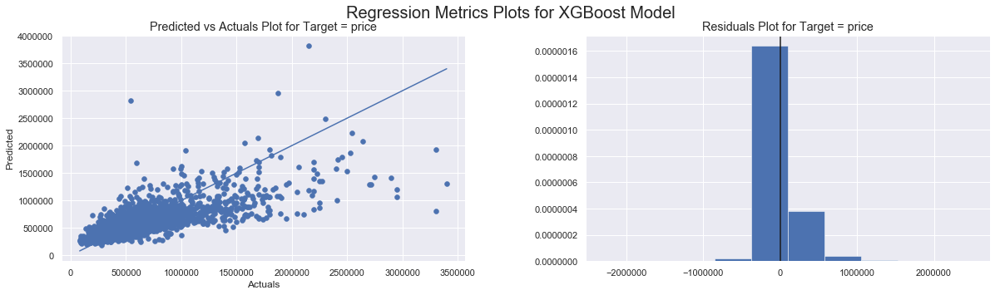

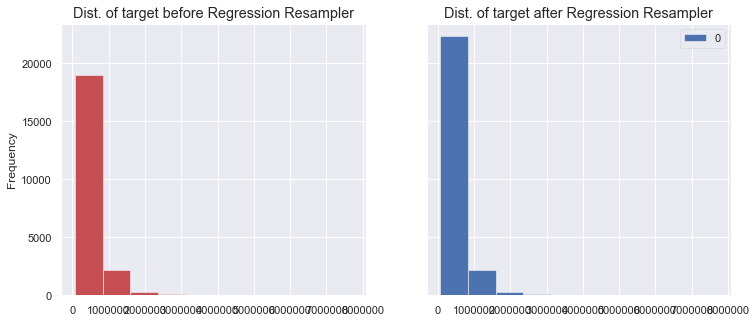

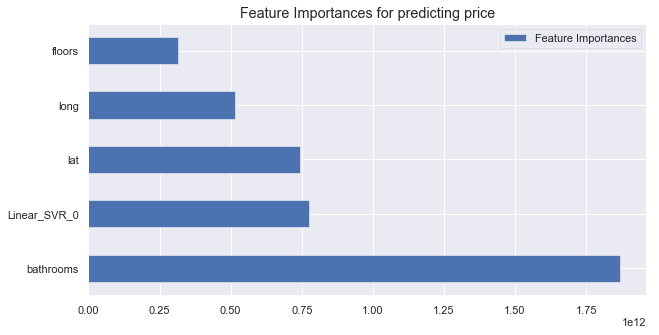

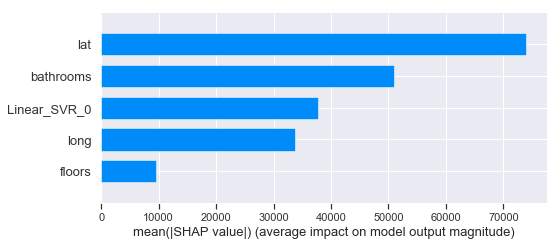

############### P R E D I C T I O N  O N  T E S T   C O M P L E T E D  #################
    Time taken thus far (in seconds) = 92
Writing Output files to disk...
    Saving predictions to .\price\price_Regression_test_modified.csv
    Saving predictions to .\price\price_Regression_submission.csv
    Saving predictions to .\price\price_Regression_train_modified.csv
###############  C O M P L E T E D  ################
Time Taken in mins = 1.5 for the Entire Process


In [4]:
from autoviml.Auto_ViML import Auto_ViML

model, features, trainm, testm = Auto_ViML(
    train=df,
    target="price",
    test="",
    sample_submission="",
    hyper_param="RS",
    feature_reduction=True,
    scoring_parameter="weighted-f1",
    KMeans_Featurizer=False,
    Boosting_Flag=True,
    Binning_Flag=False,
    Add_Poly=False,
    Stacking_Flag=True,
    Imbalanced_Flag=True,
    verbose=3
)